In [1]:
import sys
import stlearn as st
st.settings.set_figure_params(dpi=300)
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import sys
file = Path("../stimage").resolve()
parent= file.parent
sys.path.append(str(parent))
from PIL import Image
from stimage._utils import gene_plot, Read10X, ReadOldST, tiling
from stimage._model import CNN_NB_multiple_genes
from stimage._data_generator import DataGenerator
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np
import scanpy as sc

In [58]:
BASE_PATH = Path("/clusterdata/uqxtan9/Xiao/STimage/dataset/breast_cancer_10x_visium")
TILE_PATH = Path("/tmp") / "tiles"
TILE_PATH.mkdir(parents=True, exist_ok=True)

SAMPLE = "block1"
Sample1 = st.Read10X(BASE_PATH / SAMPLE, 
                  library_id=SAMPLE, 
                  count_file="V1_Breast_Cancer_Block_A_Section_1_filtered_feature_bc_matrix.h5",
                  quality="fulres",)
                  #source_image_path=BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif")
img = plt.imread(BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif", 0)
Sample1.uns["spatial"][SAMPLE]['images']["fulres"] = img

SAMPLE = "block2"
Sample2 = st.Read10X(BASE_PATH / SAMPLE, 
                  library_id=SAMPLE, 
                  count_file="V1_Breast_Cancer_Block_A_Section_2_filtered_feature_bc_matrix.h5",
                  quality="fulres",)
                  #source_image_path=BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif")
img = plt.imread(BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_2_image.tif", 0)
Sample2.uns["spatial"][SAMPLE]['images']["fulres"] = img

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [39]:
sc.pp.highly_variable_genes(Sample1, n_top_genes=2000)

In [43]:
Sample1.var_names[Sample1.var.highly_variable]

Index(['LINC02593', 'SAMD11', 'AGRN', 'GABRD', 'AJAP1', 'RNF207', 'PIK3CD',
       'CASZ1', 'ANGPTL7', 'AC254633.1',
       ...
       'MOSPD1', 'FHL1', 'FGF13', 'HMGB3', 'AC244102.4', 'HAUS7', 'PNCK',
       'SRPK3', 'LAGE3', 'MT-ND6'],
      dtype='object', length=2000)

In [ ]:
Y = Sample1.to_df()[Sample1.to_df().sum().sort_values(ascending=False).index[:10]]

In [ ]:
from sklearn import preprocessing
MinMax_scaler_y = preprocessing.MinMaxScaler(feature_range =(0, 1))

In [ ]:
Y = pd.DataFrame(MinMax_scaler_y.fit_transform(Y))

In [ ]:
Y = Y.apply(lambda x: pd.cut(x, bins=[-0.01, 0.33, 0.66, 1], labels = [0, 1, 2]))

In [ ]:
Y.apply(pd.value_counts)

In [59]:
gene_list=["SLITRK6", "PGM5", "LINC00645", 
           "TTLL12", "COX6C", "CPB1",
           "KRT5", "MALAT1", "CD74"]
gene_list

['SLITRK6',
 'PGM5',
 'LINC00645',
 'TTLL12',
 'COX6C',
 'CPB1',
 'KRT5',
 'MALAT1',
 'CD74']

In [60]:
for adata in [
    Sample1,
    Sample2,
]:
#     count_df = adata.to_df()
#     count_df[count_df <=1] = 0
#     count_df[count_df >1] = 1
#     adata.X = count_df
#     adata[:,gene_list]
    st.pp.filter_genes(adata,min_cells=3)
#     st.pp.normalize_total(adata)
    st.pp.log1p(adata)
#     st.pp.scale(adata)

    # pre-processing for spot image
    TILE_PATH_ = TILE_PATH / list(adata.uns["spatial"].keys())[0]
    TILE_PATH_.mkdir(parents=True, exist_ok=True)
    tiling(adata, TILE_PATH_, crop_size=900)

Log transformation step is finished in adata.X


Tiling image: 100%|██████████ [ time left: 00:00 ]


Log transformation step is finished in adata.X


Tiling image: 100%|██████████ [ time left: 00:00 ]


In [61]:
n_genes = len(gene_list)
training_index = Sample1.obs.sample(frac=0.7, random_state=1).index
training_dataset = Sample1[training_index,].copy()

valid_index = Sample1.obs.index.isin(training_index)
valid_dataset = Sample1[~valid_index,].copy()

test_dataset = Sample2.copy()

train_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator(adata=training_dataset, 
                          genes=gene_list, aug=False),
            output_types=(tf.float32, tuple([tf.float32]*n_genes)), 
            output_shapes=([299,299,3], tuple([1]*n_genes))
)
train_gen_ = train_gen.shuffle(buffer_size=500).batch(128).repeat(3).cache().prefetch(tf.data.experimental.AUTOTUNE)
valid_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator(adata=valid_dataset, 
                          genes=gene_list), 
            output_types=(tf.float32, tuple([tf.float32]*n_genes)), 
            output_shapes=([299,299,3], tuple([1]*n_genes))
)
valid_gen_ = valid_gen.shuffle(buffer_size=500).batch(128).repeat(3).cache().prefetch(tf.data.experimental.AUTOTUNE)
test_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator(adata=test_dataset, 
                          genes=gene_list), 
            output_types=(tf.float32, tuple([tf.float32]*n_genes)), 
            output_shapes=([299,299,3], tuple([1]*n_genes))
)
test_gen_ = test_gen.batch(1)

In [62]:
model = CNN_NB_multiple_genes((299, 299, 3), n_genes)
callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20,
                                            restore_best_weights=False)

In [63]:
train_history = model.fit(train_gen_,
                          epochs=100,
                          validation_data=valid_gen_,
                          callbacks=[callback]
                          )

Epoch 1/100
63/63 [==============================] - 79s 1s/step - loss: 20.8405 - gene_0_loss: 1.4743 - gene_1_loss: 0.7064 - gene_2_loss: 0.8533 - gene_3_loss: 1.5767 - gene_4_loss: 3.1769 - gene_5_loss: 2.5537 - gene_6_loss: 0.4616 - gene_7_loss: 4.5410 - gene_8_loss: 5.4965 - val_loss: 13.3385 - val_gene_0_loss: 1.0595 - val_gene_1_loss: 0.6227 - val_gene_2_loss: 0.7633 - val_gene_3_loss: 1.3734 - val_gene_4_loss: 2.5653 - val_gene_5_loss: 1.9790 - val_gene_6_loss: 0.4038 - val_gene_7_loss: 2.3025 - val_gene_8_loss: 2.2690
Epoch 2/100
63/63 [==============================] - 21s 329ms/step - loss: 13.1034 - gene_0_loss: 1.0543 - gene_1_loss: 0.5849 - gene_2_loss: 0.7732 - gene_3_loss: 1.3382 - gene_4_loss: 2.5162 - gene_5_loss: 1.9458 - gene_6_loss: 0.3818 - gene_7_loss: 2.2608 - gene_8_loss: 2.2481 - val_loss: 12.5093 - val_gene_0_loss: 1.0142 - val_gene_1_loss: 0.5865 - val_gene_2_loss: 0.7285 - val_gene_3_loss: 1.2915 - val_gene_4_loss: 2.3902 - val_gene_5_loss: 1.8298 - val_gen

63/63 [==============================] - 21s 330ms/step - loss: 10.0190 - gene_0_loss: 0.7995 - gene_1_loss: 0.4909 - gene_2_loss: 0.6379 - gene_3_loss: 1.1224 - gene_4_loss: 1.8832 - gene_5_loss: 1.4455 - gene_6_loss: 0.2556 - gene_7_loss: 1.6170 - gene_8_loss: 1.7670 - val_loss: 10.2031 - val_gene_0_loss: 0.8107 - val_gene_1_loss: 0.5467 - val_gene_2_loss: 0.6426 - val_gene_3_loss: 1.1501 - val_gene_4_loss: 1.8952 - val_gene_5_loss: 1.4626 - val_gene_6_loss: 0.2926 - val_gene_7_loss: 1.6267 - val_gene_8_loss: 1.7758
Epoch 32/100
63/63 [==============================] - 21s 330ms/step - loss: 10.0010 - gene_0_loss: 0.7975 - gene_1_loss: 0.4902 - gene_2_loss: 0.6367 - gene_3_loss: 1.1212 - gene_4_loss: 1.8801 - gene_5_loss: 1.4431 - gene_6_loss: 0.2548 - gene_7_loss: 1.6142 - gene_8_loss: 1.7634 - val_loss: 10.1896 - val_gene_0_loss: 0.8091 - val_gene_1_loss: 0.5466 - val_gene_2_loss: 0.6421 - val_gene_3_loss: 1.1494 - val_gene_4_loss: 1.8925 - val_gene_5_loss: 1.4608 - val_gene_6_loss

63/63 [==============================] - 21s 330ms/step - loss: 9.6666 - gene_0_loss: 0.7589 - gene_1_loss: 0.4730 - gene_2_loss: 0.6126 - gene_3_loss: 1.0969 - gene_4_loss: 1.8252 - gene_5_loss: 1.3994 - gene_6_loss: 0.2388 - gene_7_loss: 1.5633 - gene_8_loss: 1.6985 - val_loss: 9.9604 - val_gene_0_loss: 0.7848 - val_gene_1_loss: 0.5457 - val_gene_2_loss: 0.6332 - val_gene_3_loss: 1.1377 - val_gene_4_loss: 1.8433 - val_gene_5_loss: 1.4307 - val_gene_6_loss: 0.2887 - val_gene_7_loss: 1.5816 - val_gene_8_loss: 1.7150
Epoch 62/100
63/63 [==============================] - 21s 330ms/step - loss: 9.6589 - gene_0_loss: 0.7580 - gene_1_loss: 0.4726 - gene_2_loss: 0.6119 - gene_3_loss: 1.0963 - gene_4_loss: 1.8240 - gene_5_loss: 1.3984 - gene_6_loss: 0.2383 - gene_7_loss: 1.5622 - gene_8_loss: 1.6971 - val_loss: 9.9559 - val_gene_0_loss: 0.7844 - val_gene_1_loss: 0.5457 - val_gene_2_loss: 0.6330 - val_gene_3_loss: 1.1375 - val_gene_4_loss: 1.8422 - val_gene_5_loss: 1.4301 - val_gene_6_loss: 0.

63/63 [==============================] - 21s 331ms/step - loss: 9.4837 - gene_0_loss: 0.7366 - gene_1_loss: 0.4609 - gene_2_loss: 0.5963 - gene_3_loss: 1.0824 - gene_4_loss: 1.7981 - gene_5_loss: 1.3765 - gene_6_loss: 0.2277 - gene_7_loss: 1.5379 - gene_8_loss: 1.6673 - val_loss: 9.8649 - val_gene_0_loss: 0.7766 - val_gene_1_loss: 0.5463 - val_gene_2_loss: 0.6296 - val_gene_3_loss: 1.1345 - val_gene_4_loss: 1.8193 - val_gene_5_loss: 1.4183 - val_gene_6_loss: 0.2899 - val_gene_7_loss: 1.5616 - val_gene_8_loss: 1.6889
Epoch 92/100
63/63 [==============================] - 21s 330ms/step - loss: 9.4789 - gene_0_loss: 0.7360 - gene_1_loss: 0.4606 - gene_2_loss: 0.5958 - gene_3_loss: 1.0820 - gene_4_loss: 1.7974 - gene_5_loss: 1.3759 - gene_6_loss: 0.2274 - gene_7_loss: 1.5373 - gene_8_loss: 1.6665 - val_loss: 9.8628 - val_gene_0_loss: 0.7764 - val_gene_1_loss: 0.5464 - val_gene_2_loss: 0.6295 - val_gene_3_loss: 1.1345 - val_gene_4_loss: 1.8187 - val_gene_5_loss: 1.4180 - val_gene_6_loss: 0.

In [64]:
test_predictions = model.predict(test_gen_)
from scipy.stats import nbinom
y_preds = []
for i in range(n_genes):
    n = test_predictions[i][:, 0]
    p = test_predictions[i][:, 1]
    y_pred = nbinom.mean(n, p)
    y_preds.append(y_pred)
test_dataset.obsm["predicted_gene"] = np.array(y_preds).transpose()

In [65]:
model.save("./CNN_NB_9genes_model_900.h5")

In [66]:
test_dataset_ = test_dataset[:,gene_list].copy()
test_dataset_.X = test_dataset_.obsm["predicted_gene"]

SLITRK6


/scratch/imb/Xiao/STimage/stimage/_utils.py:110: MatplotlibDeprecationWarning: The 'cmap' parameter to Colorbar has no effect because it is overridden by the mappable; it is deprecated since 3.3 and will be removed two minor releases later.
  cb = plt.colorbar(plot, cax=fig.add_axes(


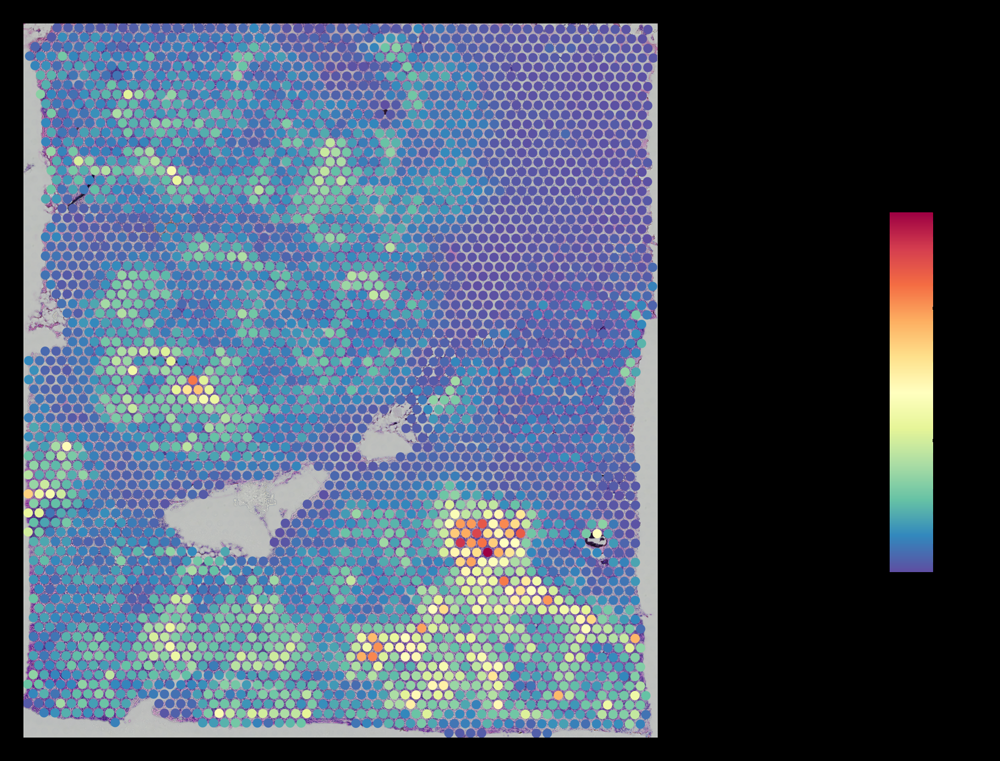

PGM5


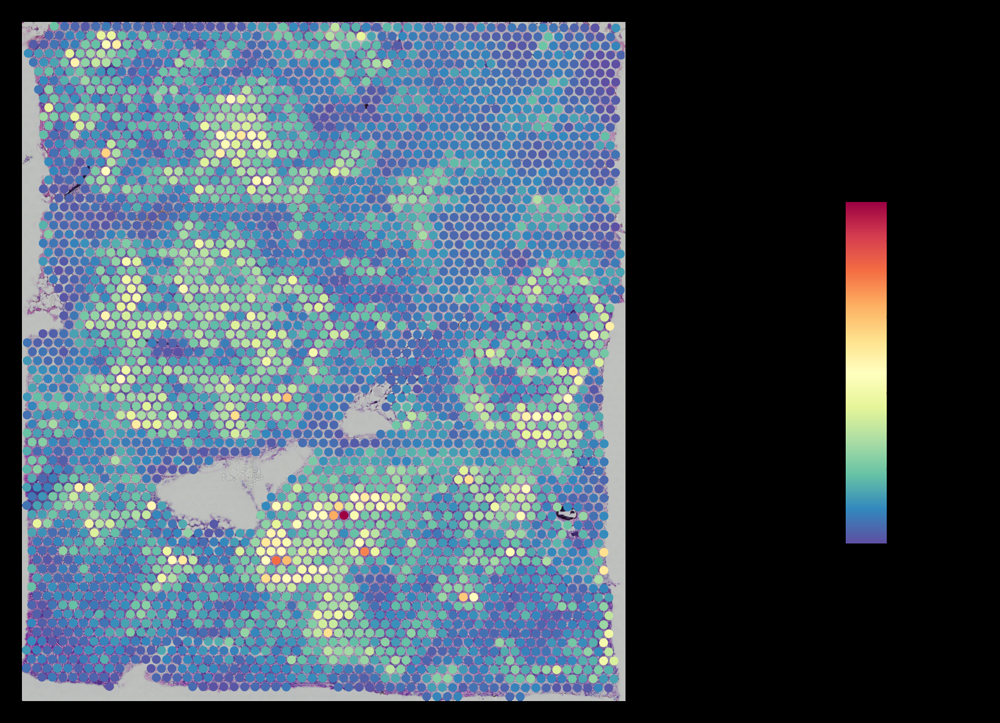

LINC00645


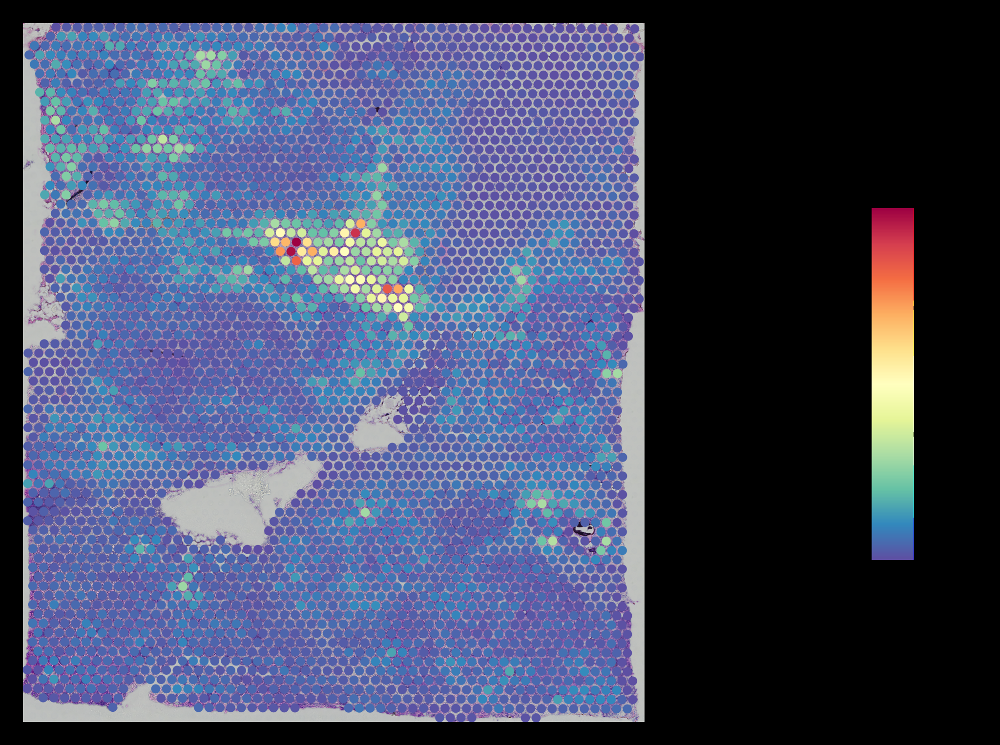

TTLL12


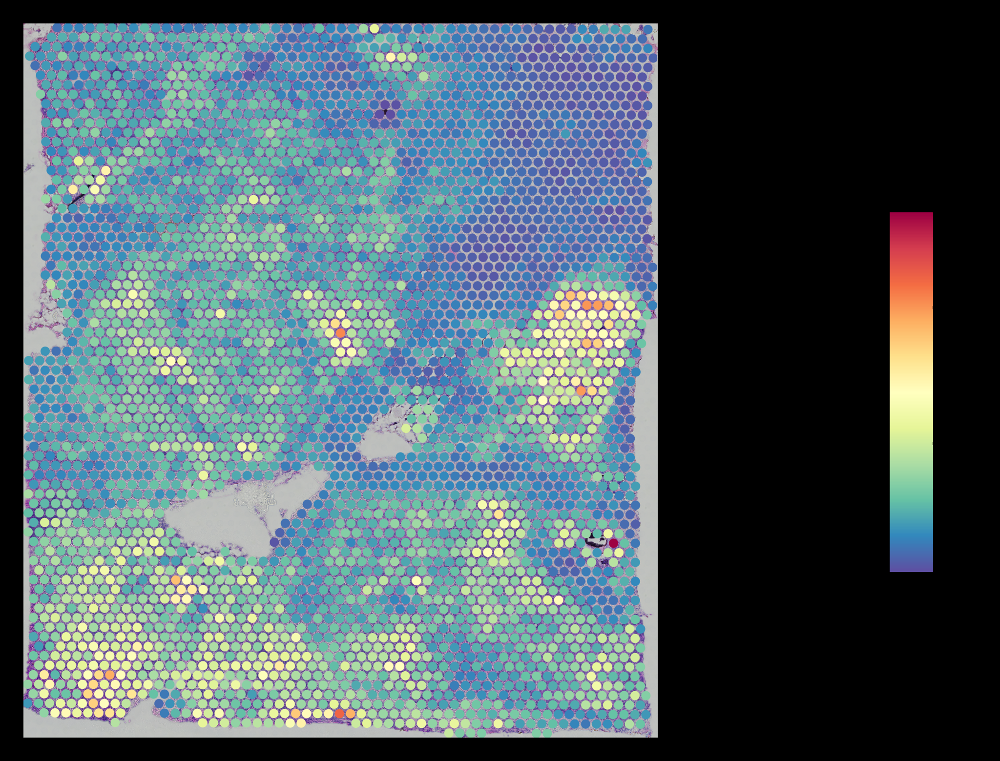

COX6C


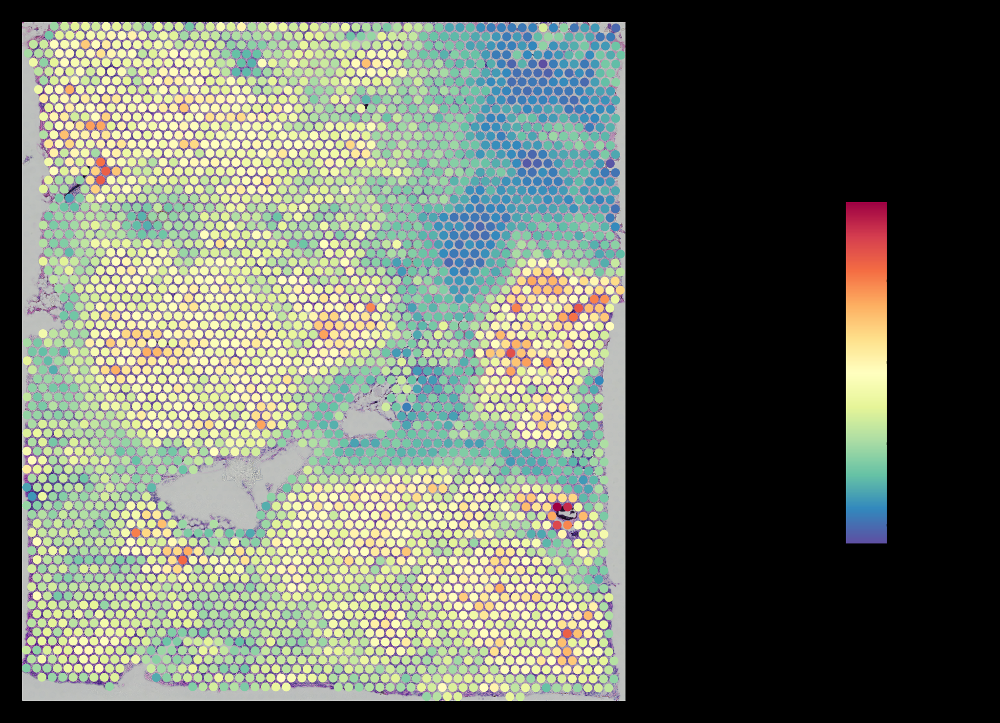

CPB1


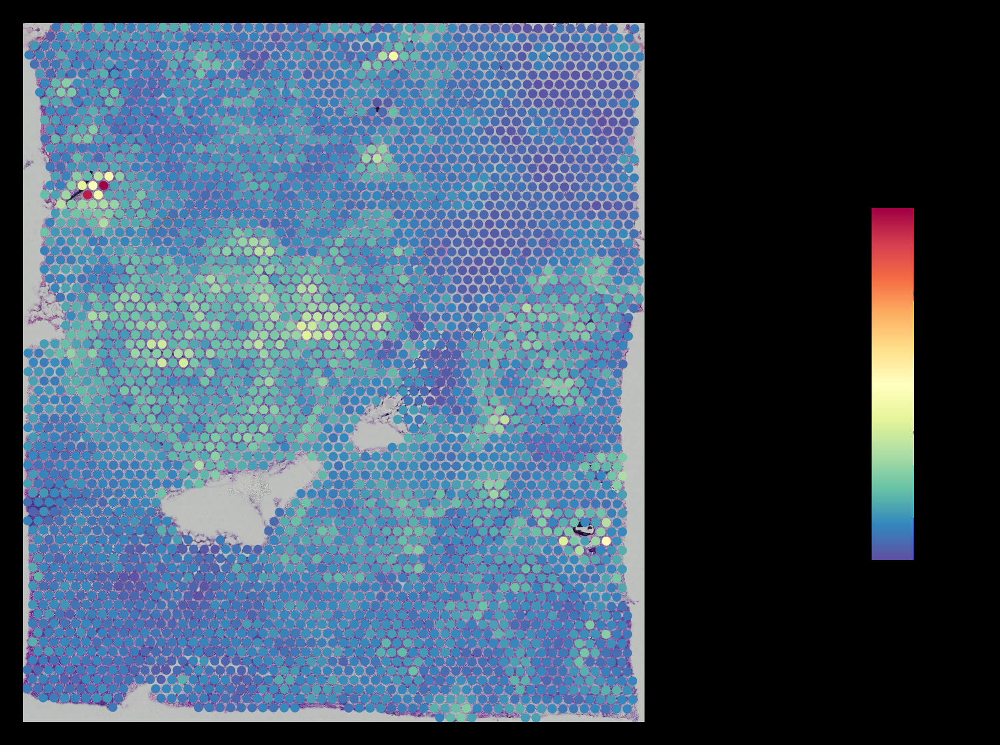

KRT5


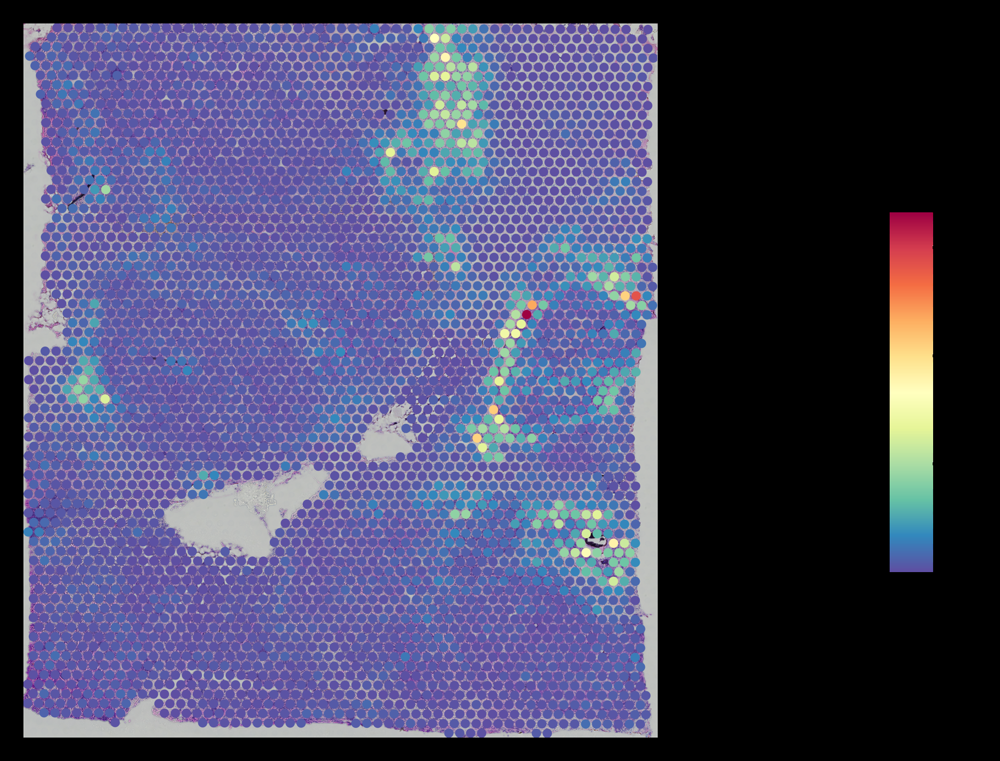

MALAT1


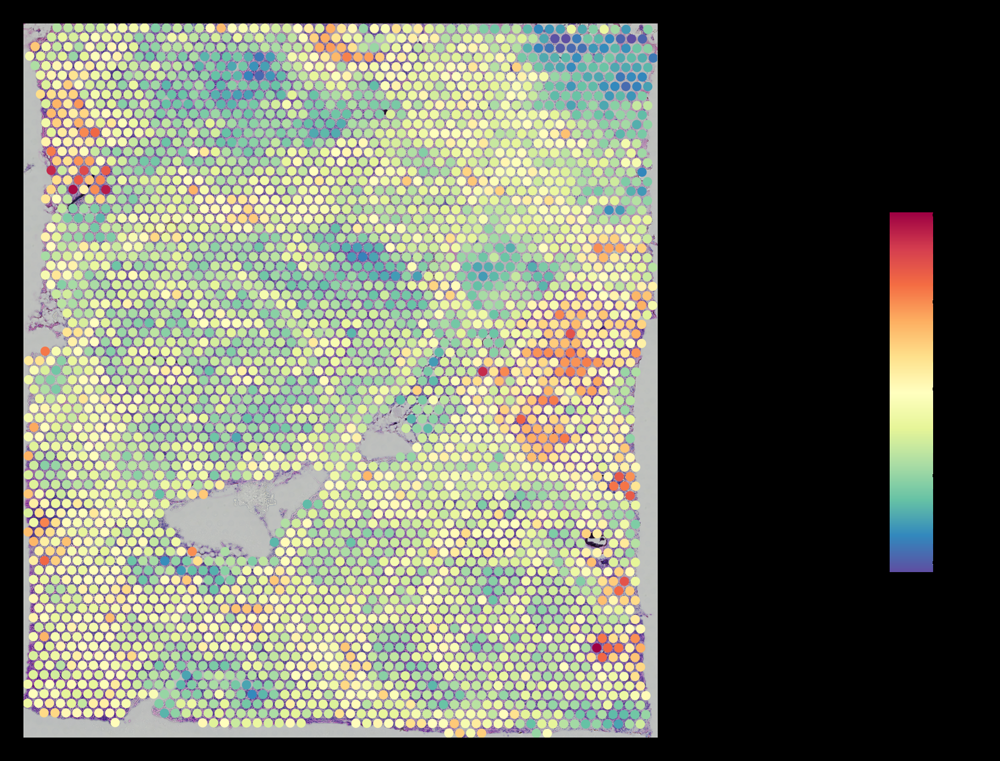

CD74


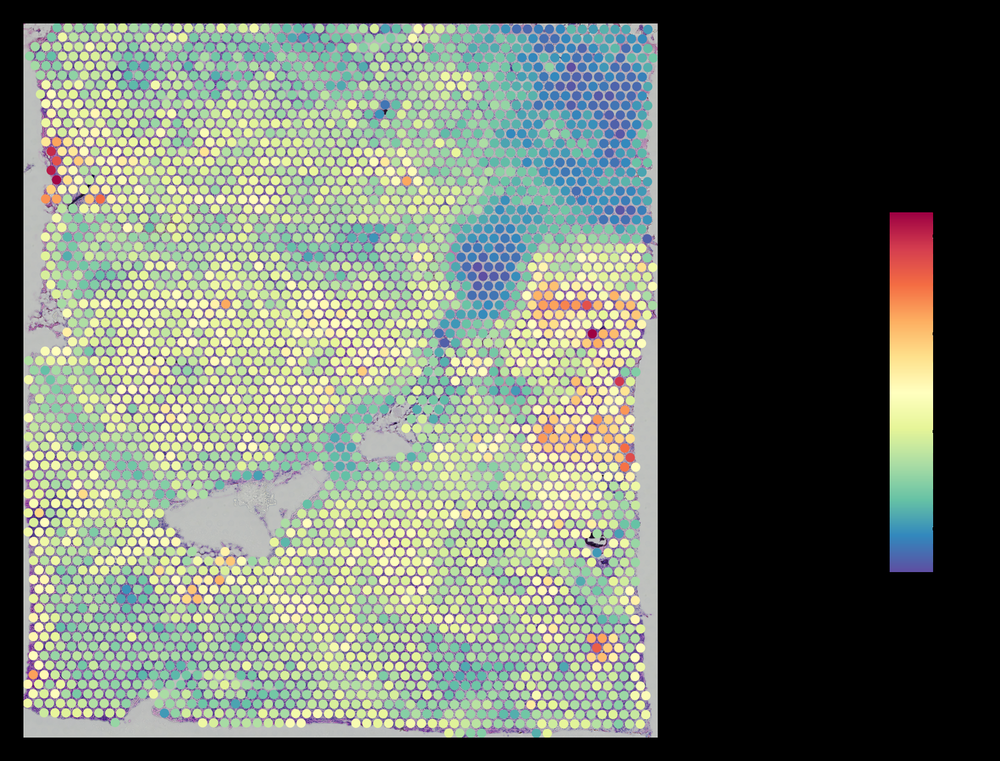

In [67]:
for i in gene_list:
    print(i)
    gene_plot(test_dataset_, genes=i, spot_size=8) 

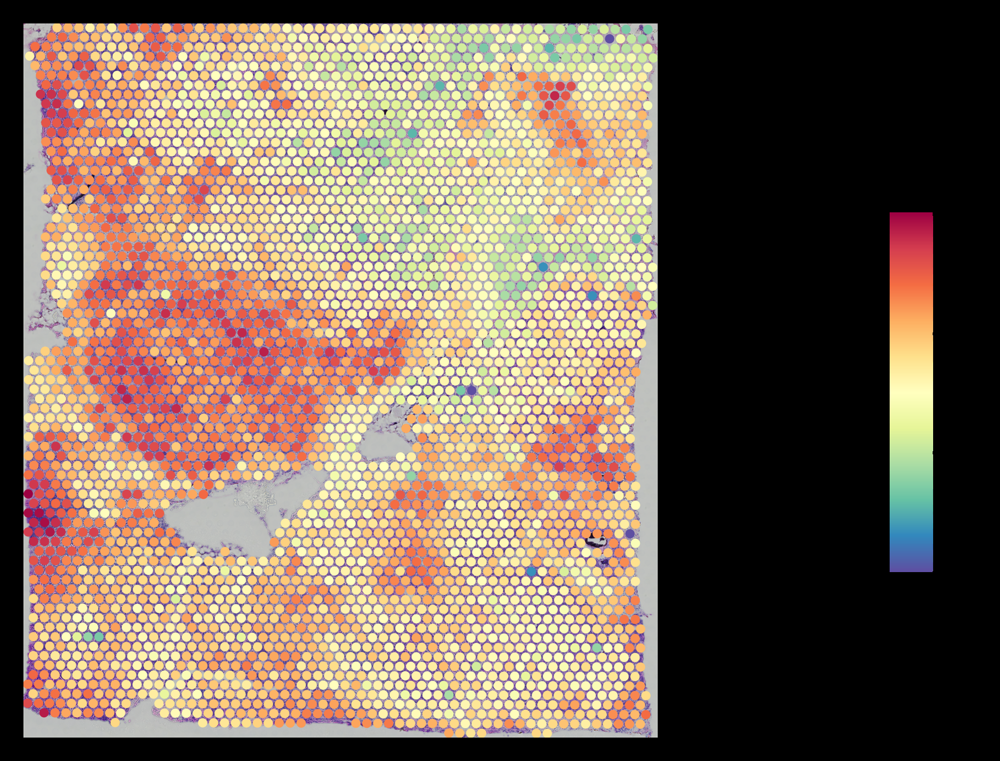

In [68]:
gene_plot(test_dataset, genes="CD74", spot_size=8)

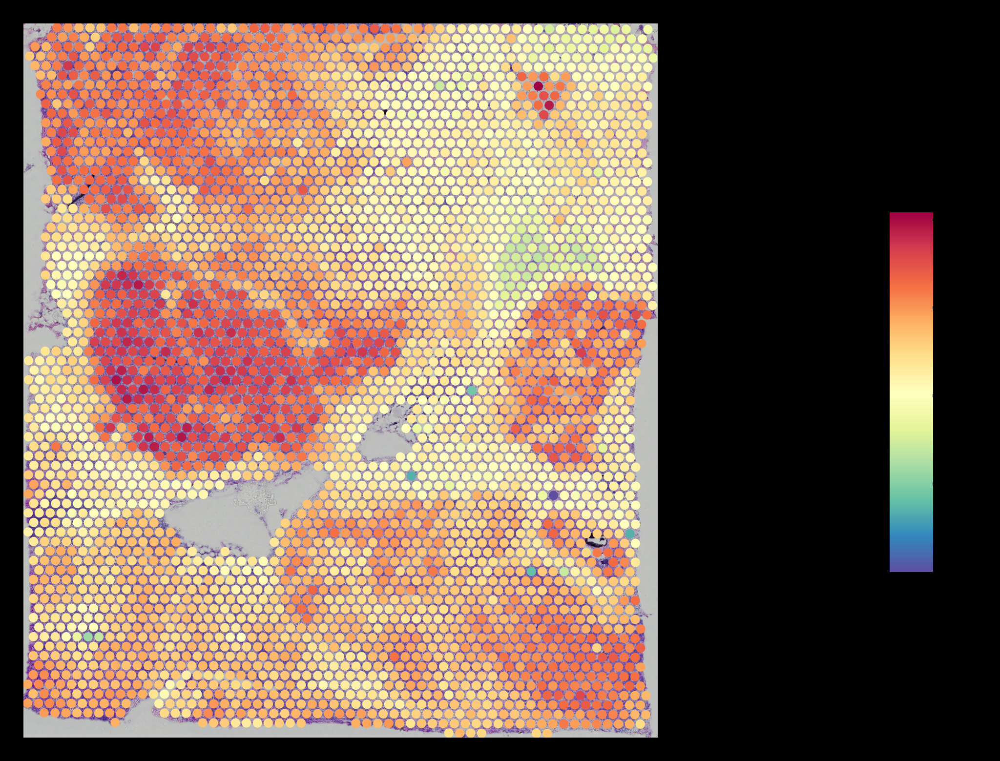

In [69]:
gene_plot(test_dataset, genes="COX6C", spot_size=8)

In [70]:
gene_list[4]

'COX6C'

In [71]:
def model_predict_gene(gene):
    i = gene_list.index(gene)
    from scipy.stats import nbinom
    def model_predict(x):
        test_predictions = model.predict(x)
        n = test_predictions[i][:, 0]
        p = test_predictions[i][:, 1]
        y_pred = nbinom.mean(n, p)
        return y_pred.reshape(-1,1)
    return model_predict

In [72]:
from lime import lime_image
explainer = lime_image.LimeImageExplainer()

In [73]:
import skimage
from skimage.color import rgb2hed
from skimage.feature import peak_local_max
from skimage.segmentation import watershed
from skimage.measure import label
import scipy as sp
from scipy import ndimage as ndi
from skimage.morphology import area_opening
import math
from sklearn.linear_model import LinearRegression, SGDRegressor

In [ ]:
for image, label_ in test_gen.shuffle(200).take(1):
    annotation_hed = rgb2hed(image)
    annotation_h = annotation_hed[:,:,0]
    annotation_h *= 255.0 / np.percentile(annotation_h, q=90)
#     annotation_h = np.clip(annotation_h, a_min=0, a_max=255)
    thresh = skimage.filters.threshold_otsu(annotation_h)
    im_fgnd_mask = sp.ndimage.morphology.binary_fill_holes(
        annotation_h < thresh
    )
    distance = ndi.distance_transform_edt(im_fgnd_mask)
    coords = peak_local_max(distance, footprint=np.ones((5, 5)), labels=im_fgnd_mask)
    mask = np.zeros(distance.shape, dtype=bool)
    mask[tuple(coords.T)] = True
    markers, _ = ndi.label(mask)
    labels = watershed(annotation_h, markers, mask=im_fgnd_mask)
    im_nuclei_seg_mask = area_opening(labels, area_threshold=64).astype(np.int)
    map_dic = dict(zip(np.unique(im_nuclei_seg_mask), np.arange(len(np.unique(im_nuclei_seg_mask)))))
    im_nuclei_seg_mask = np.vectorize(map_dic.get)(im_nuclei_seg_mask)
    
    fig = plt.figure()
    plt.subplot(2, 2, 1)
    plt.imshow(image.numpy().astype(int))
    plt.subplot(2, 2, 2)
    plt.imshow(im_fgnd_mask)
    plt.subplot(2, 2, 3)
    plt.imshow(annotation_h,cmap="gray")
    plt.subplot(2, 2, 4)
    plt.imshow(image.numpy().astype(int))
    plt.imshow(skimage.color.label2rgb(im_nuclei_seg_mask,
                                       im_fgnd_mask, 
                                       bg_label=0),
               alpha=im_fgnd_mask,
               origin='upper')
    plt.show()

In [74]:
def watershed_segment(image):
    annotation_hed = rgb2hed(image)
    annotation_h = annotation_hed[:,:,0]
    annotation_h *= 255.0 / np.percentile(annotation_h, q=80)
#     annotation_h = np.clip(annotation_h, a_min=0, a_max=255)
    thresh = skimage.filters.threshold_otsu(annotation_h)
    im_fgnd_mask = sp.ndimage.morphology.binary_fill_holes(
        annotation_h < thresh
    )
    distance = ndi.distance_transform_edt(im_fgnd_mask)
    coords = peak_local_max(distance, footprint=np.ones((5, 5)), labels=im_fgnd_mask)
    mask = np.zeros(distance.shape, dtype=bool)
    mask[tuple(coords.T)] = True
    markers, _ = ndi.label(mask)
    labels = watershed(annotation_h, markers, mask=im_fgnd_mask)
    im_nuclei_seg_mask = area_opening(labels, area_threshold=64).astype(np.int)
    map_dic = dict(zip(np.unique(im_nuclei_seg_mask), np.arange(len(np.unique(im_nuclei_seg_mask)))))
    im_nuclei_seg_mask = np.vectorize(map_dic.get)(im_nuclei_seg_mask)
    return im_nuclei_seg_mask



In [ ]:
gene1 = gene_list[8]
gene2 = gene_list[4]
for image, label_ in test_gen.shuffle(2000).take(1):
    explanation = explainer.explain_instance(image.numpy().astype("double"), 
                                             model_predict_gene(gene1), 
                                             top_labels=1, num_samples=1000,
                                             hide_color=0,
#                                              num_features=10000,
#                                              model_regressor=SGDRegressor(),
                                             segmentation_fn=watershed_segment)
    dict_heatmap1 = dict(explanation.local_exp[explanation.top_labels[0]])
    heatmap1 = np.vectorize(dict_heatmap1.get)(explanation.segments)
    prediction = model_predict_gene(gene1)(np.expand_dims(image.numpy(), 0)).ravel()
    print("{}:".format(gene1))
    print("prediction: " + str(prediction))
    print("ground truth: " + str(label_[8].numpy().ravel()))
    fig = plt.figure()
    plt.subplot(1, 3, 1)
    plt.imshow(image.numpy().astype(int))
    plt.subplot(1, 3, 2)
    plt.imshow(heatmap1, alpha=1, cmap = 'RdYlBu_r', vmax=1, vmin=-1)
    plt.subplot(1, 3, 3)
    plt.imshow(image.numpy().astype(int))
    plt.imshow(heatmap1, alpha=0.3, cmap = 'RdYlBu_r', vmax=1, vmin=-1)
    plt.tight_layout()
    plt.show()
    
    explanation = explainer.explain_instance(image.numpy().astype("double"), 
                                             model_predict_gene(gene2), 
                                             top_labels=1, num_samples=1000,
                                             hide_color=0,
#                                              num_features=10000,
#                                              model_regressor=SGDRegressor(),
                                             segmentation_fn=watershed_segment)
    dict_heatmap1 = dict(explanation.local_exp[explanation.top_labels[0]])
    heatmap1 = np.vectorize(dict_heatmap1.get)(explanation.segments)
    prediction = model_predict_gene(gene2)(np.expand_dims(image.numpy(), 0)).ravel()
    print("{}:".format(gene2))
    print("prediction: " + str(prediction))
    print("ground truth: " + str(label_[4].numpy().ravel()))
    fig = plt.figure()
    plt.subplot(2, 3, 4)
    plt.imshow(image.numpy().astype(int))
    plt.subplot(2, 3, 5)
    plt.imshow(heatmap1, alpha=1, cmap = 'RdYlBu_r', vmax=1, vmin=-1)
    plt.subplot(2, 3, 6)
    plt.imshow(image.numpy().astype(int))
    plt.imshow(heatmap1, alpha=0.3, cmap = 'RdYlBu_r', vmax=1, vmin=-1)
    plt.tight_layout()
    plt.show()
    

  0%|          | 0/1000 [00:00<?, ?it/s]

In [1]:
import lime